### Opening an Image

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

In [2]:
path = 'data/page_01.jpg'
img = cv2.imread(path)


In [3]:
def display(im_path):
    dpi = 80
    im_data = plt.imread(im_path)
    height = im_data.shape[0]
    width = im_data.shape[1]
    
    figsize = width / float(dpi),  height / float(dpi)
    
    fig = plt.figure(figsize = figsize)
    ax = fig.add_axes([0,0,1,1])
    
    ax.axis('off')
    
    ax.imshow(im_data,cmap = 'gray')
    
    plt.show()

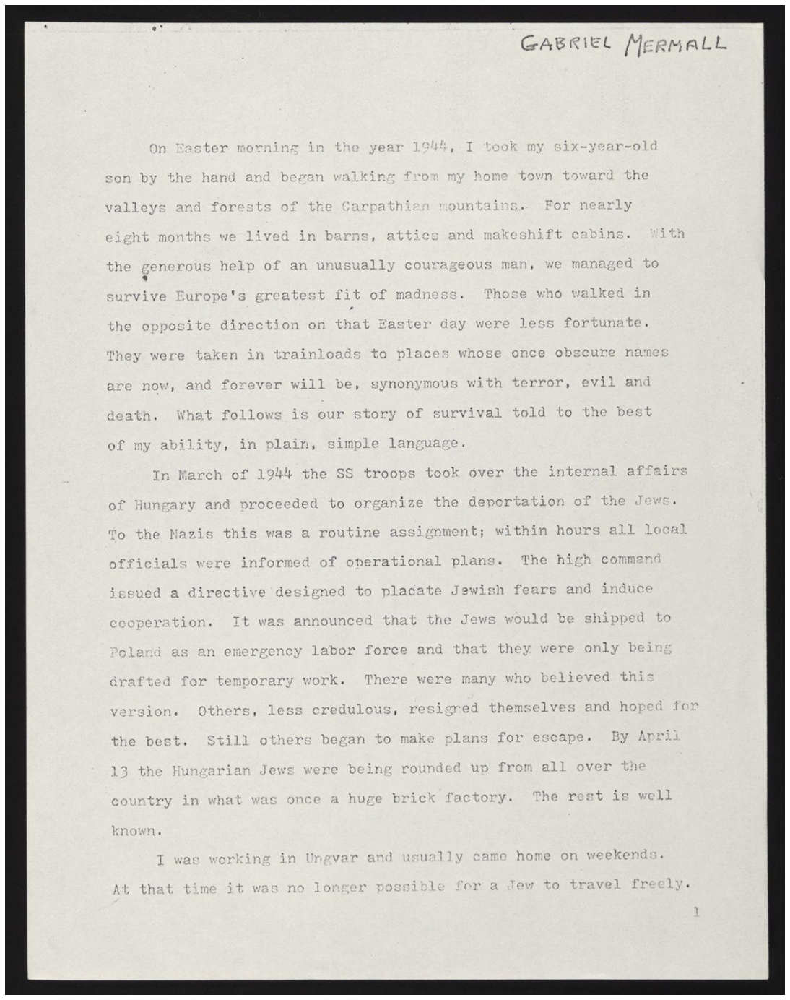

In [4]:
display(path)

### Invert an Image 

In [6]:
inverted_img = cv2.bitwise_not(img)
cv2.imwrite('temp/inverted_page1.jpg',inverted_img)

True

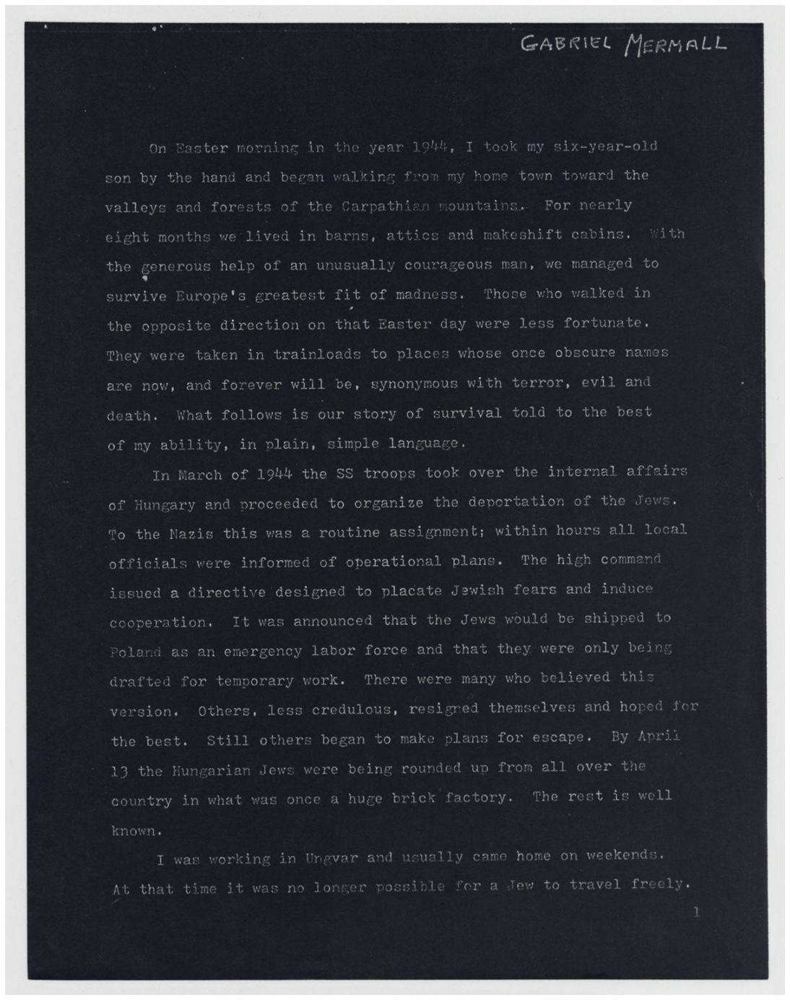

In [7]:
display('temp/inverted_page1.jpg')

### RESCALING

### BINARIZATION

Here we convert an image into black and white. For this the image must be in grayscale at the beginning

In [8]:
color_img = cv2.imread('data/country_image.jpg')

In [9]:
def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

In [10]:
gray_image = grayscale(color_img)

In [11]:
cv2.imwrite('temp/gray.jpg',gray_image)

True

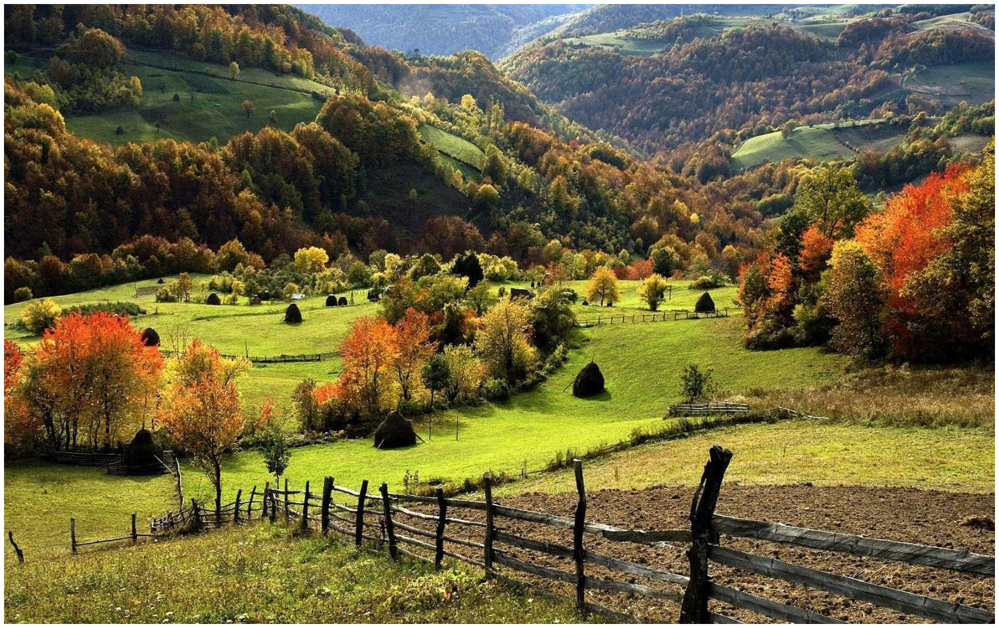

In [12]:
display('data/country_image.jpg')

In [13]:
gray_image.shape

(1200, 1920)

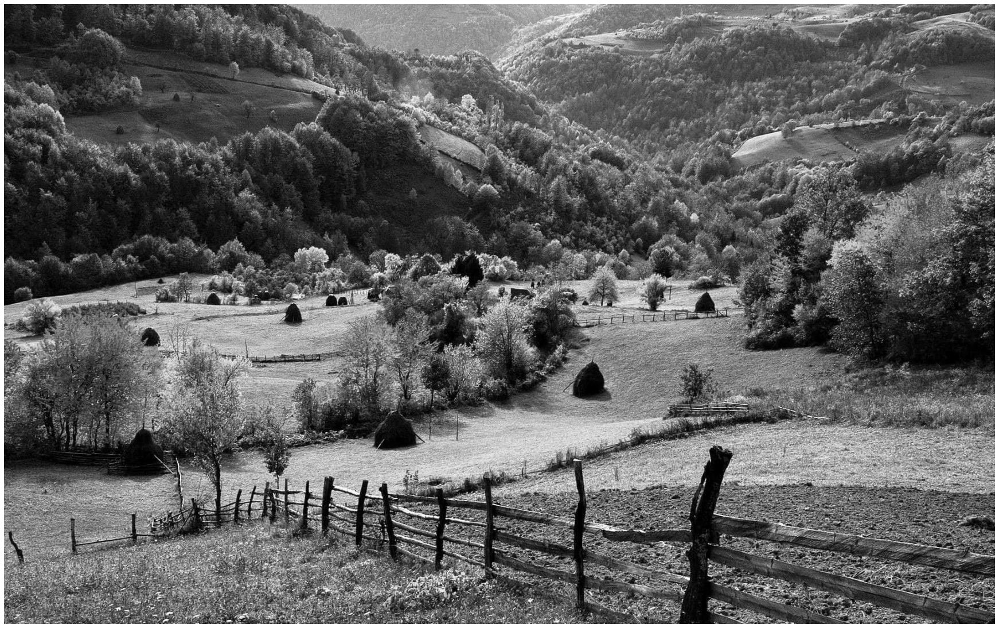

In [14]:
display('temp/gray.jpg')

In [17]:
thresh, im_bw = cv2.threshold(gray_image,200,255,cv2.THRESH_BINARY)

In [18]:
cv2.imwrite('temp/bw_image.jpg',im_bw)

True

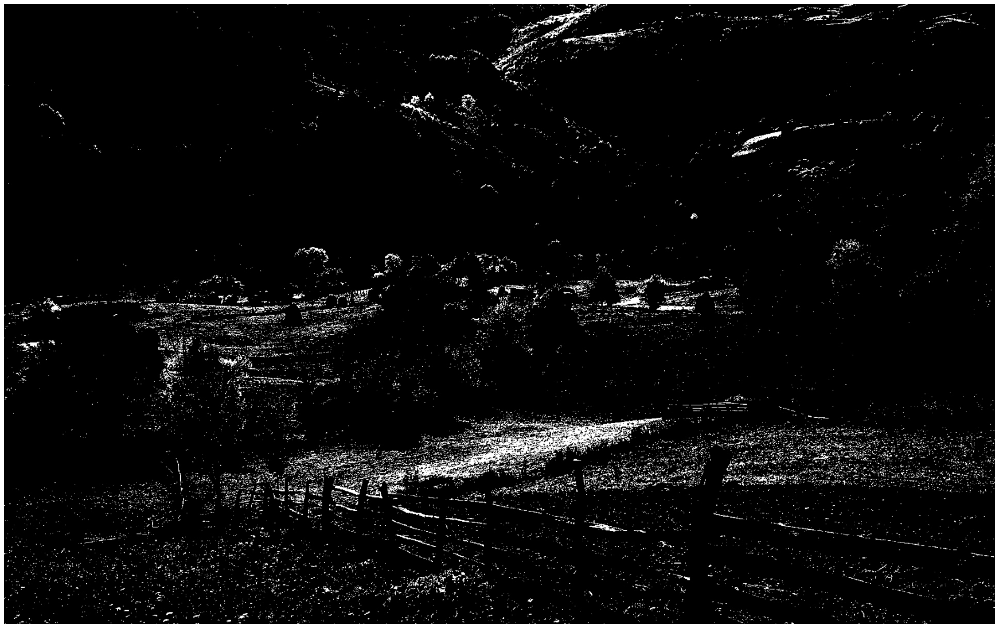

In [19]:
display('temp/bw_image.jpg')

### NOISE REMOVAL

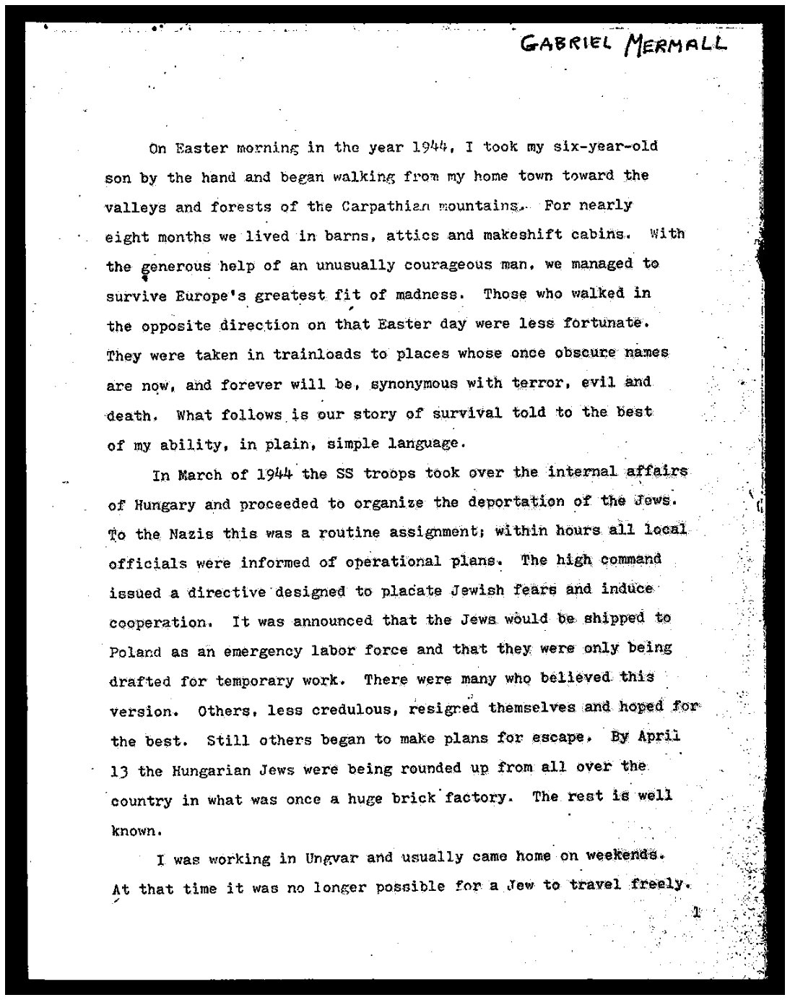

In [23]:

gray_scale_img = grayscale(img)
thresh, im_noise_bw = cv2.threshold(gray_scale_img,210,255,cv2.THRESH_BINARY)
cv2.imwrite('temp/noise_bw_image.jpg', im_noise_bw)
display('temp/noise_bw_image.jpg')

In [24]:
def noise_removal(image):
    import numpy as np
    kernel = np.ones((1, 1), np.uint8)
    image = cv2.dilate(image, kernel, iterations=50)
    kernel = np.ones((1, 1), np.uint8)
    image = cv2.erode(image, kernel, iterations=50)
    image = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
    image = cv2.medianBlur(image, 1)
    return (image)

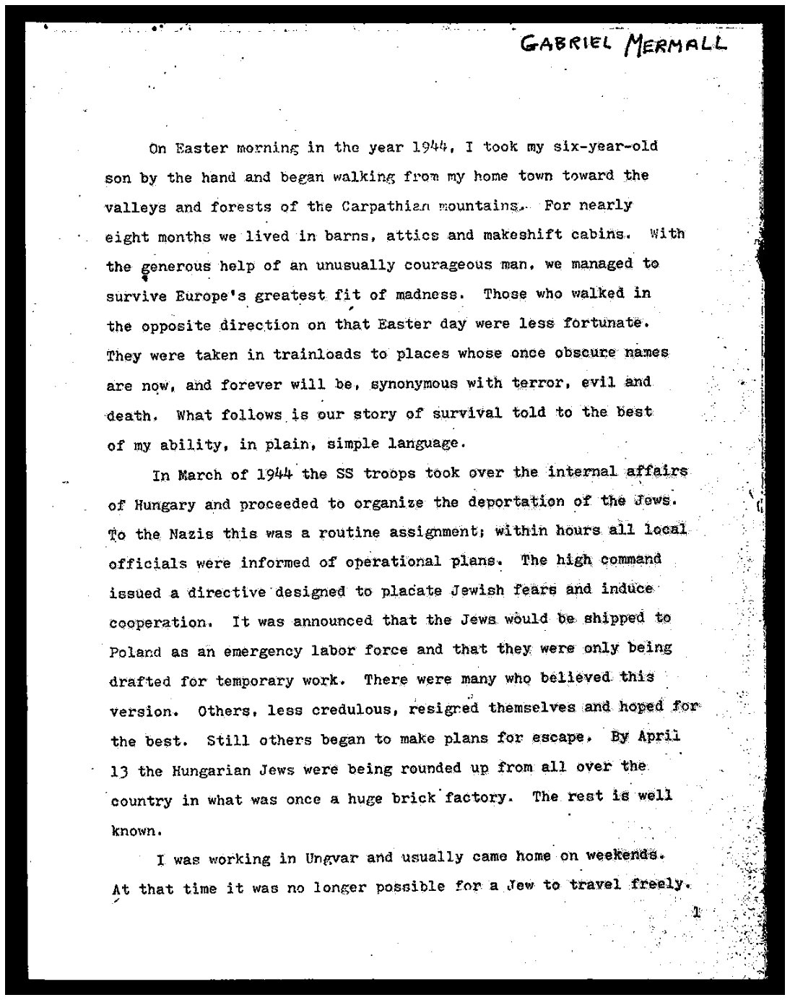

In [25]:
no_noise_image = noise_removal(im_noise_bw)
cv2.imwrite('temp/no_noise.jpg',no_noise_image)
display('temp/no_noise.jpg')

### DILATE AND ERODE

In [51]:
def thin_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

In [52]:
eroded_image = thin_font(no_noise_image)
cv2.imwrite("temp/eroded_image.jpg", eroded_image)

True

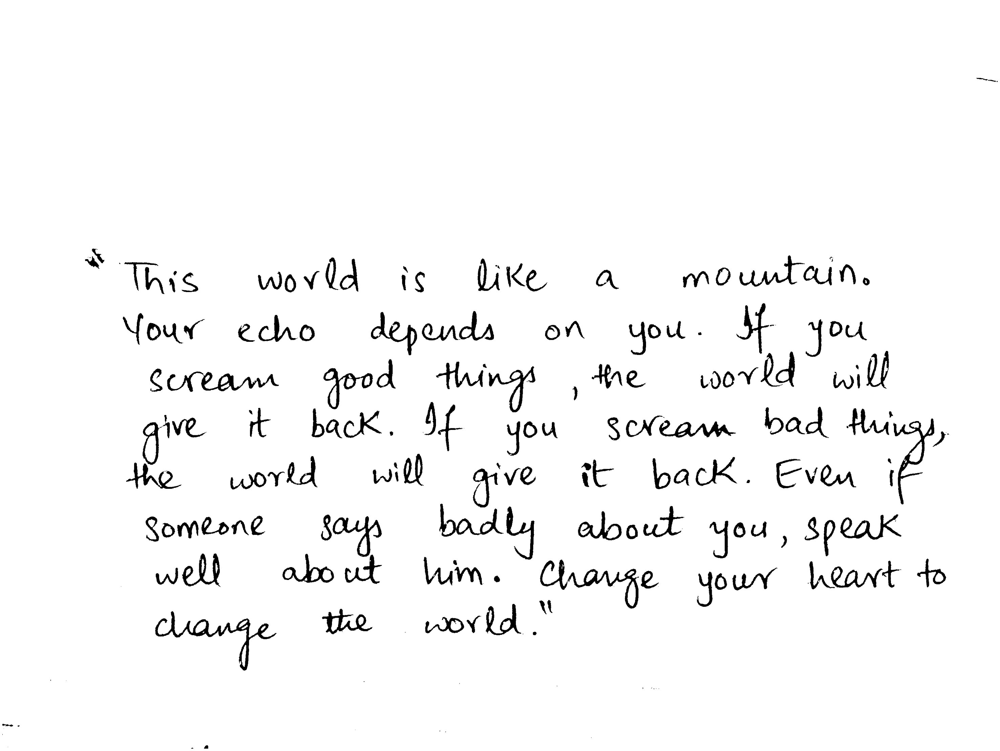

In [53]:
display("temp/eroded_image.jpg")

In [54]:
def thick_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

In [56]:
dilated_image = thick_font(no_noise_image)
cv2.imwrite("temp/dilated_image.jpg", dilated_image)

True

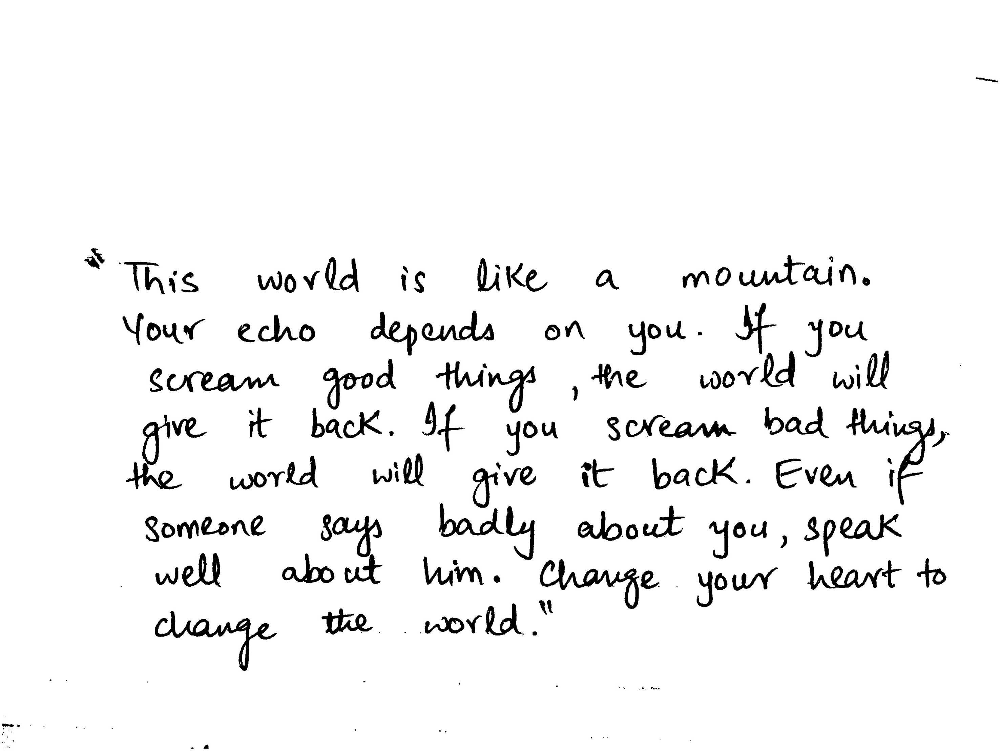

In [57]:
display("temp/dilated_image.jpg")

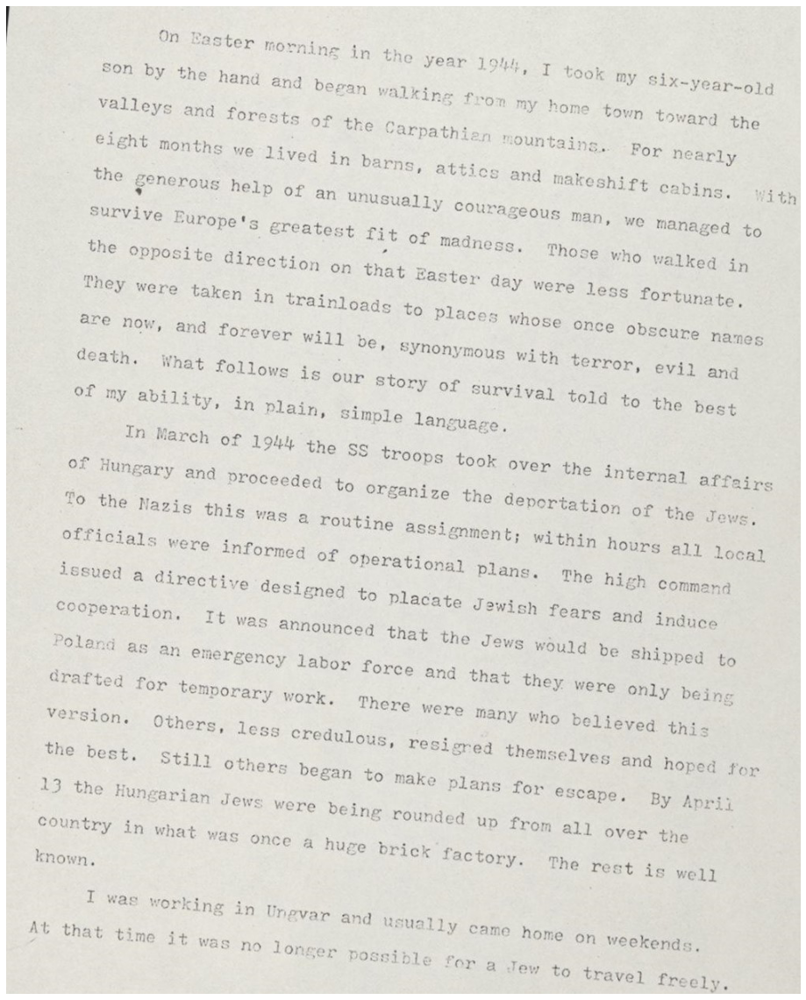

In [58]:
new = cv2.imread("data/page_01_rotated.JPG")
display("data/page_01_rotated.JPG")

In [60]:
import numpy as np

def getSkewAngle(cvImage) -> float:
    # Prep image, copy, convert to gray scale, blur, and threshold
    newImage = cvImage.copy()
    gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (9, 9), 0)
    thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    # Apply dilate to merge text into meaningful lines/paragraphs.
    # Use larger kernel on X axis to merge characters into single line, cancelling out any spaces.
    # But use smaller kernel on Y axis to separate between different blocks of text
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 5))
    dilate = cv2.dilate(thresh, kernel, iterations=2)

    # Find all contours
    contours, hierarchy = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key = cv2.contourArea, reverse = True)
    for c in contours:
        rect = cv2.boundingRect(c)
        x,y,w,h = rect
        cv2.rectangle(newImage,(x,y),(x+w,y+h),(0,255,0),2)

    # Find largest contour and surround in min area box
    largestContour = contours[0]
    print (len(contours))
    minAreaRect = cv2.minAreaRect(largestContour)
    cv2.imwrite("temp/boxes.jpg", newImage)
    # Determine the angle. Convert it to the value that was originally used to obtain skewed image
    angle = minAreaRect[-1]
    if angle < -45:
        angle = 90 + angle
    return -1.0 * angle

In [61]:
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage

In [62]:
def deskew(cvImage):
    angle = getSkewAngle(cvImage)
    return rotateImage(cvImage, -1.0 * angle)

In [63]:
fixed = deskew(new)
cv2.imwrite("temp/rotated_fixed.jpg", fixed)

28


True

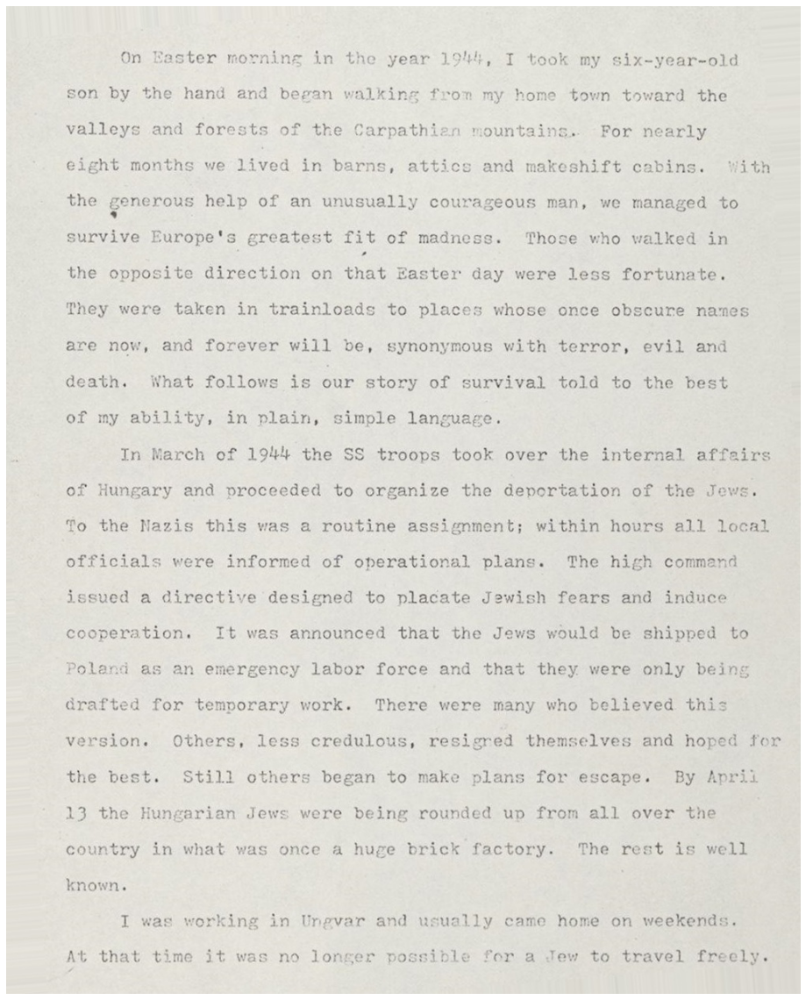

In [64]:
display("temp/rotated_fixed.jpg")

### REMOVING BORDERS

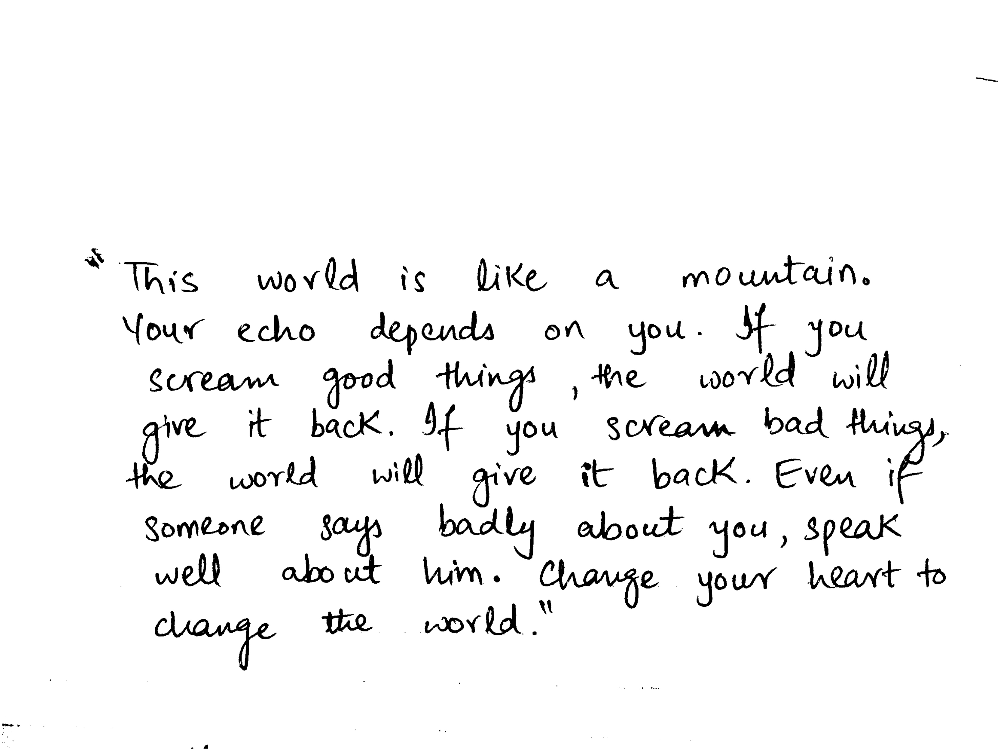

In [65]:
display("temp/no_noise.jpg")

In [66]:
def remove_borders(image):
    contours, heiarchy = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cntsSorted = sorted(contours, key=lambda x:cv2.contourArea(x))
    cnt = cntsSorted[-1]
    x, y, w, h = cv2.boundingRect(cnt)
    crop = image[y:y+h, x:x+w]
    return (crop)

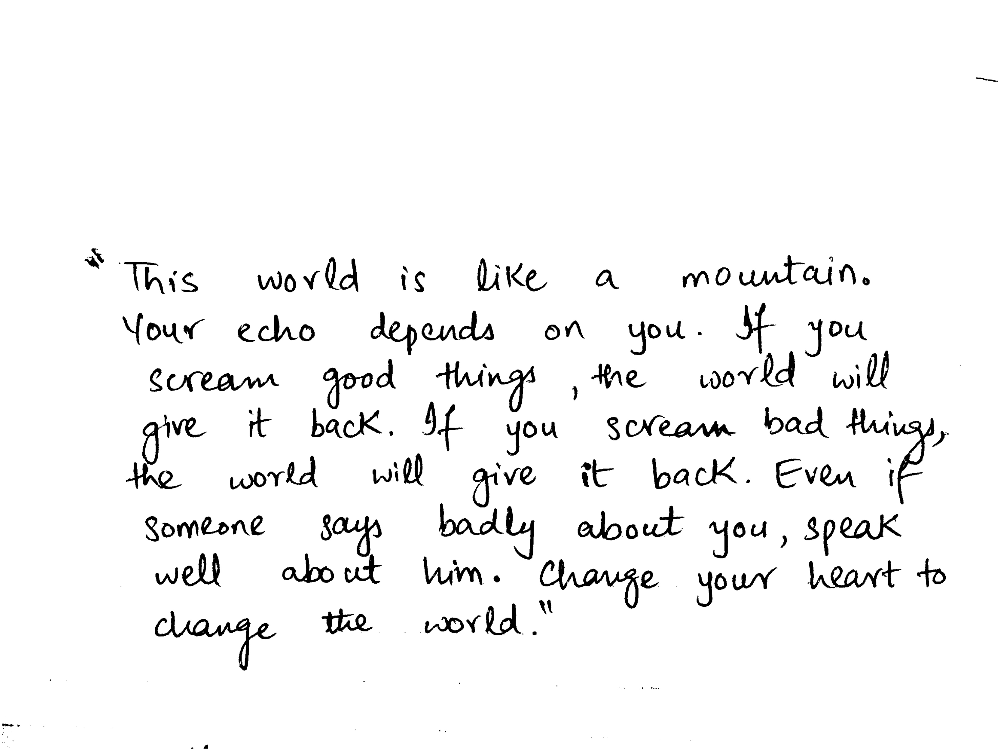

In [68]:
no_borders = remove_borders(no_noise_image)
cv2.imwrite("temp/no_borders.jpg", no_borders)
display('temp/no_borders.jpg')

### ADD MISSING BORDERS

In [69]:
color = [255, 255, 255]
top, bottom, left, right = [150]*4

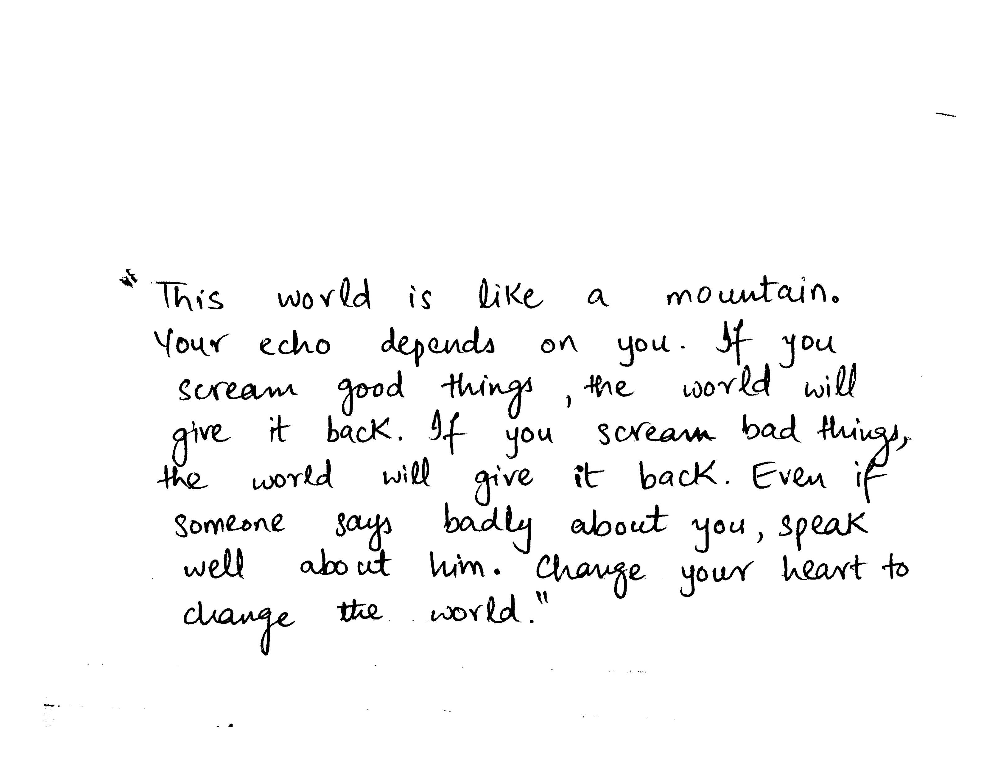

In [70]:
image_with_border = cv2.copyMakeBorder(no_borders, top, bottom, left, right, cv2.BORDER_CONSTANT, value=color)
cv2.imwrite("temp/image_with_border.jpg", image_with_border)
display("temp/image_with_border.jpg")